# 1. Import modules and load MERFISH data 

In [1]:
import numpy as np
import pandas as pd
import seaborn as sns
import anndata
import scanpy as sc
import os

import matplotlib.pyplot as plt

sc.settings.n_jobs = 24
sc.settings.set_figure_params(dpi=180, dpi_save=300, frameon=False, figsize=(4, 4), fontsize=8, facecolor='white')

# 2. Load MERLin analysis results

In [3]:
merlin_output_folder = r'I:\MERFISH_Analysis\20220314-P_brain_M1_adaptors'
# generate post-analysis folders
postanalysis_folder = os.path.join(merlin_output_folder, 'PostAnalysis')
if not os.path.exists(postanalysis_folder):
    print(f"Create postanalysis_folder: {postanalysis_folder}")
    os.makedirs(postanalysis_folder)
else:
    print(f"Use postanalysis_folder: {postanalysis_folder}")

Use postanalysis_folder: I:\MERFISH_Analysis\20220314-P_brain_M1_adaptors\PostAnalysis


In [4]:
# Load Cell information
cell_meta_data_file = os.path.join(merlin_output_folder, 'ExportCellMetadata', 'feature_metadata.csv')
cell_meta_data = pd.read_csv(cell_meta_data_file)
cell_meta_data

,Unnamed: 0,fov,volume,center_x,center_y,min_x,max_x,min_y,max_y
0,10133829621076763086991223630103332315,0,48.021507,-223.265997,-1302.757973,-225.490797,-221.041197,-1306.170773,-1299.345172
1,105991773925953562047555891343791592070,0,703.179906,-193.781996,-1410.703975,-198.706796,-188.857196,-1417.086776,-1404.321175
2,106250072532131659227259931360179572550,0,1249.737945,-159.977995,-1318.471973,-166.738795,-153.217195,-1325.610773,-1311.333173
3,109362390190094105697165869177246249578,0,109.200590,-196.103996,-1209.931970,-199.570796,-192.637196,-1212.534770,-1207.329170
4,109780137122802693753287939451494017220,0,455.242561,-154.469995,-1226.293971,-160.258795,-148.681195,-1230.678771,-1221.909170
...,...,...,...,...,...,...,...,...,...
17354,80611891685122869211935936556485141884,163,994.616859,6617.385805,-369.617987,6611.381005,6623.390605,-378.862787,-360.373187
17355,82077600051868815415131373922036276259,163,43.689264,6707.619808,-170.417382,6704.693008,6710.546608,-171.610782,-169.223982
17356,8484847311235042277356133398824242935,163,59.529443,6754.815809,-371.885987,6751.457009,6758.174609,-375.082787,-368.689187
17357,94554819090609705167906972831631918415,163,64.700561,6801.255810,-255.893984,6797.141010,6805.370610,-259.738784,-252.049184


In [5]:
# Load decoded counts information
counts_file_mer = os.path.join(merlin_output_folder, 'ExportPartitionedBarcodes', 'barcodes_per_feature.csv')
df = pd.read_csv(counts_file_mer).rename(columns={'Unnamed: 0':'index'}).set_index('index')
#blanks = [f'Blank-{i}' for i in range(1, 11)]
for _c in df.columns:
    if 'Blank-' in _c:
        df = df.drop(columns=_c)
adata = anndata.AnnData(df)
adata.obs = adata.obs.merge(cell_meta_data, left_index=True, right_on='Unnamed: 0').set_index('Unnamed: 0')

In [6]:
df

,1700022I11Rik,1810046K07Rik,5031425F14Rik,5730522E02Rik,Acta2,Adam2,Adamts2,Adamts4,Adra1b,Alk,...,Unc13c,Unc5b,Unc5d,Ust,Vipr2,Vtn,Vwc2,Wipf3,Wnt7b,Zfp804b
index,,,,,,,,,,,,,,,,,,,,,
10133829621076763086991223630103332315,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
105991773925953562047555891343791592070,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
106250072532131659227259931360179572550,0.0,0.0,0.0,0.0,0.0,0.0,0.0,2.0,0.0,0.0,...,0.0,5.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0
109362390190094105697165869177246249578,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
109780137122802693753287939451494017220,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
80611891685122869211935936556485141884,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,...,0.0,2.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
82077600051868815415131373922036276259,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
8484847311235042277356133398824242935,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


# 4. Preprocess and filter the MERFISH data 

In [7]:
# Calculate quality control metrics
sc.pp.calculate_qc_metrics(adata, percent_top=None, log1p=False, inplace=True)

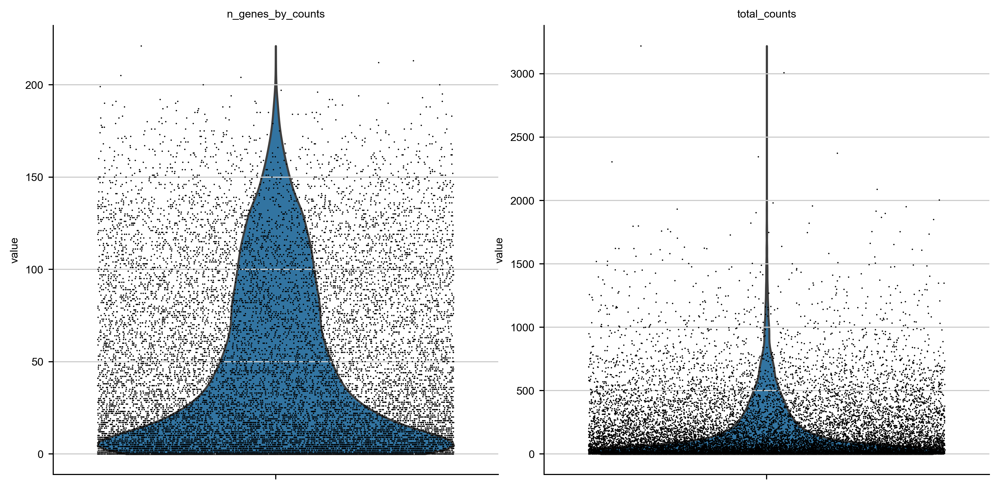

In [8]:
# A violin plot of some of the computed quality measures:
# - the number of genes expressed in the count matrix
# - the total counts per cell
sc.pl.violin(adata, ['n_genes_by_counts', 'total_counts'],
             jitter=0.4, multi_panel=True)

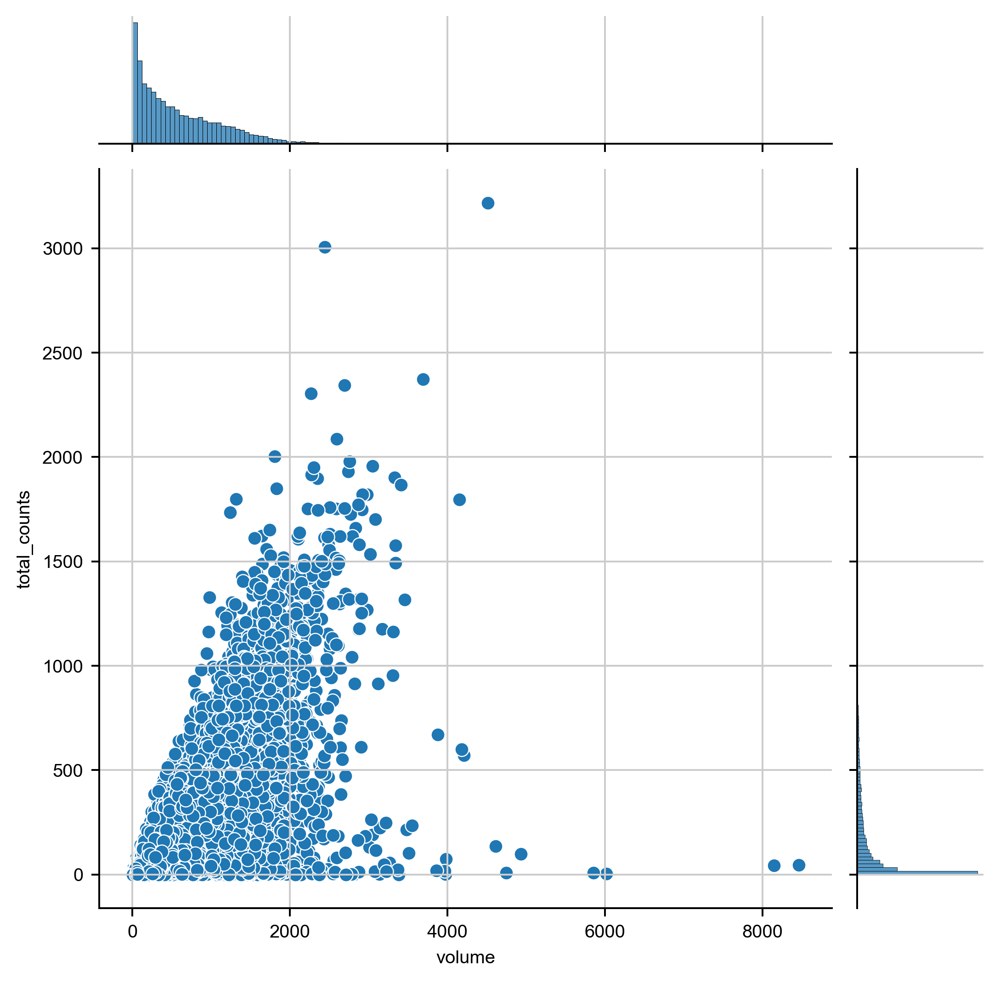

In [9]:
sns.jointplot(data=adata.obs, x='volume', y='total_counts')

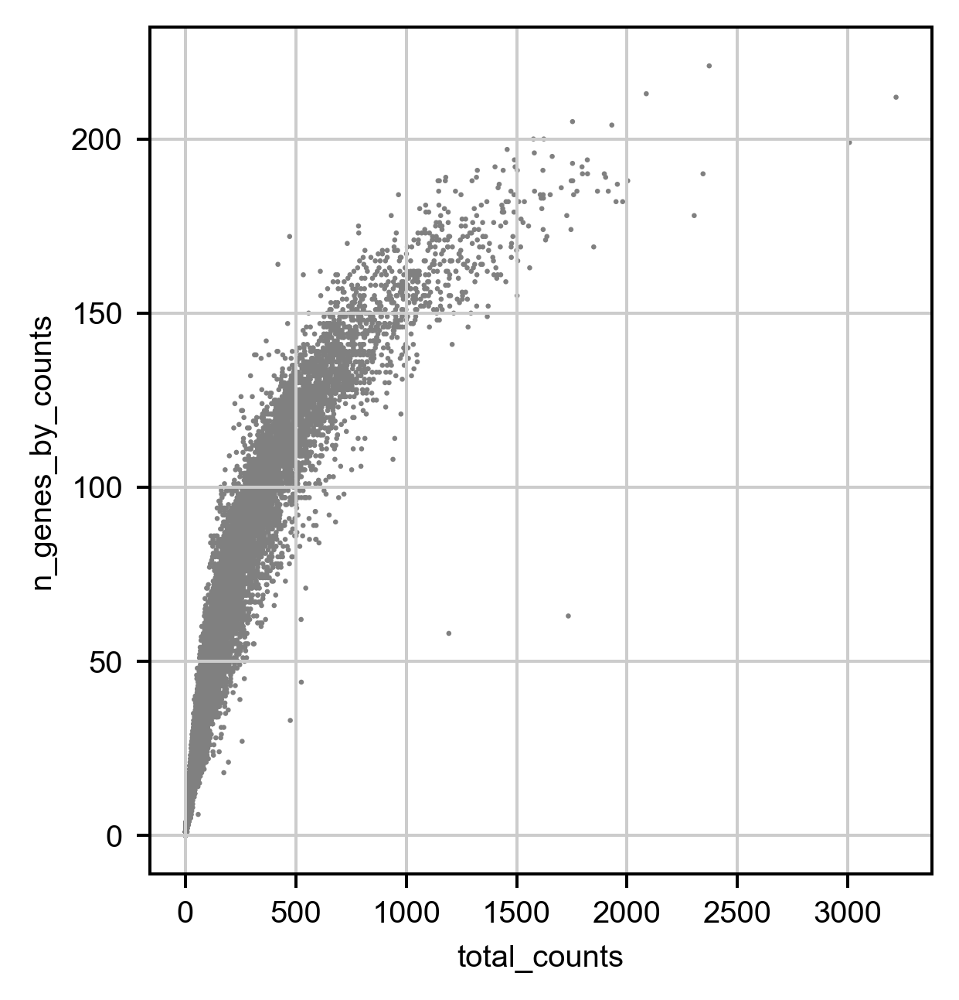

In [10]:
# Plot the distributions of gene counts
sc.pl.scatter(adata, x='total_counts', y='n_genes_by_counts')

In [11]:
gene_count_threshold = 20
total_count_threshold = 20
volume_threshold = 100

# Filtering
adata = adata[adata.obs['n_genes_by_counts'] > gene_count_threshold]
adata = adata[adata.obs['total_counts'] > total_count_threshold]
adata = adata[adata.obs['volume'] > volume_threshold]

print(len(adata) / len(cell_meta_data) , len(adata))

0.5883403421856098 10213


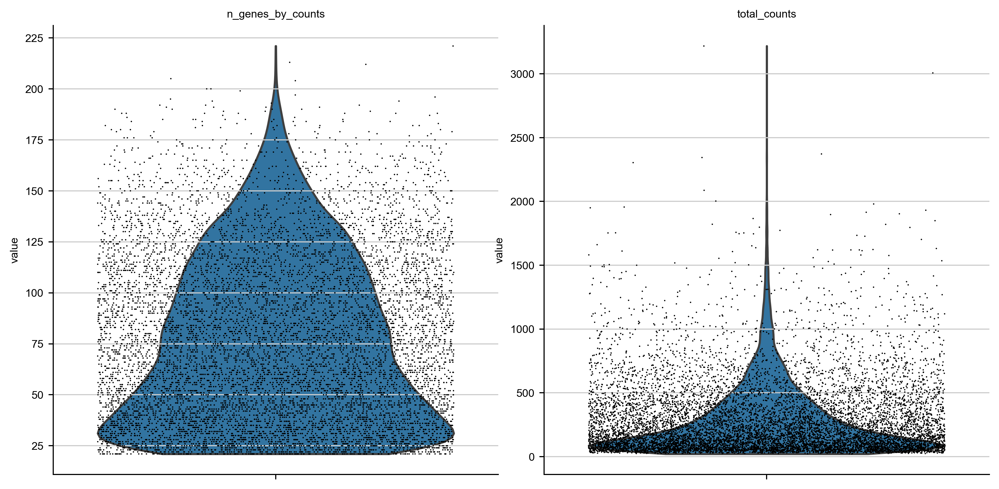

In [12]:
# A violin plot of some of the computed quality measures:
# - the number of genes expressed in the count matrix
# - the total counts per cell
sc.pl.violin(adata, ['n_genes_by_counts', 'total_counts'],
             jitter=0.4, multi_panel=True)

In [13]:
np.mean(adata.obs['total_counts'])

287.1723327636719

## 4. PCA and UMAP of the MERFISH data (for quick test)

E:\Users\puzheng\AppData\anaconda3\envs\merlin_postanalysis\lib\site-packages\scanpy\preprocessing\_normalization.py:155: UserWarning: Revieved a view of an AnnData. Making a copy.
  view_to_actual(adata)


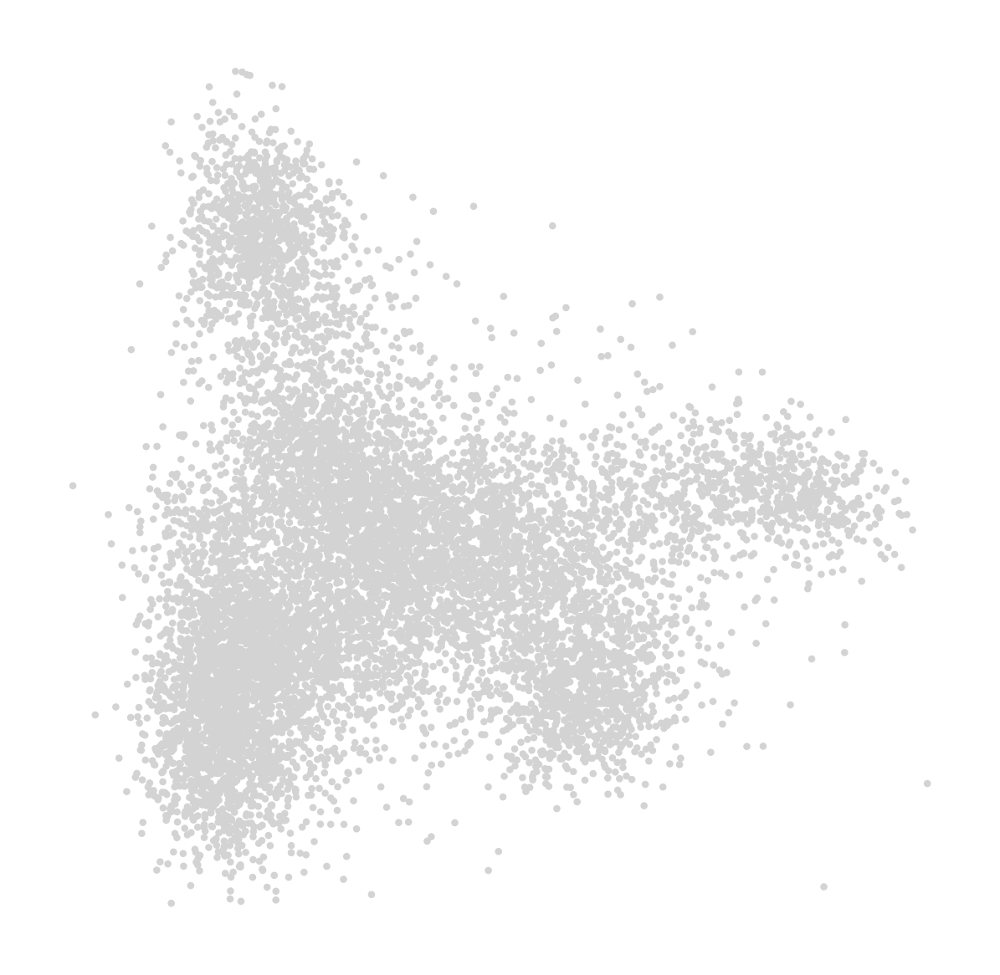

Wall time: 19.4 s


In [14]:
%%time
# Total-count normalize (library-size correct) the data matrix to 10,000 reads per cell
sc.pp.normalize_total(adata, target_sum=1e2)
# Logarithmize the data
sc.pp.log1p(adata)
# Regress out total counts
sc.pp.regress_out(adata, 'total_counts')
# Convert gene expressions to Z-scores
sc.pp.scale(adata, max_value=10)
# Principal component analysis
sc.tl.pca(adata, svd_solver='arpack')
# Plot the PCA results
sc.pl.pca(adata)

In [15]:
%%time
# Computing the neighborhood graph
sc.pp.neighbors(adata, n_neighbors=10, n_pcs=50)

Wall time: 23.7 s


In [16]:
%%time
# Clustering
sc.tl.leiden(adata, resolution=1)

Wall time: 940 ms


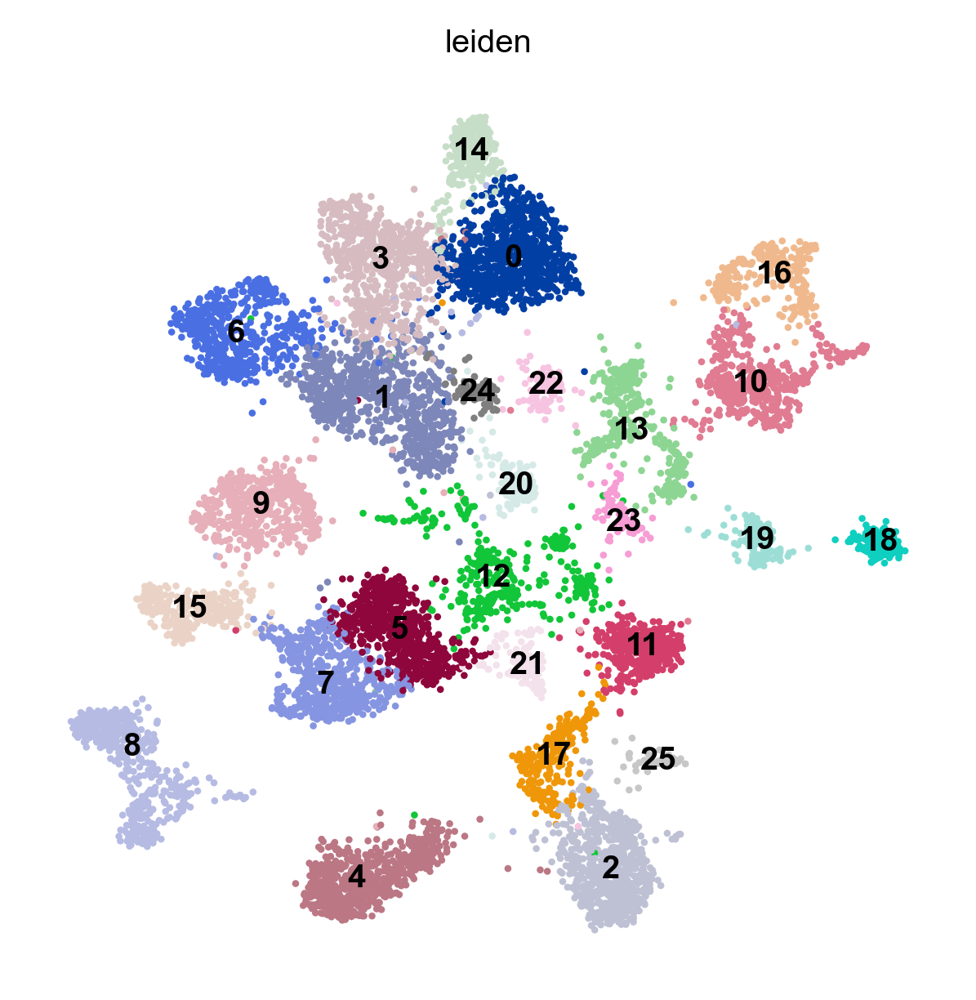

Wall time: 10.7 s


In [17]:
%%time
# Embed with UMAP
sc.tl.umap(adata)
# Plot the UMAP
sc.pl.umap(adata, color='leiden', legend_loc='on data')

(-756.6304823638872, 7190.088402695395, -2470.8858518976717, 1051.089821055904)

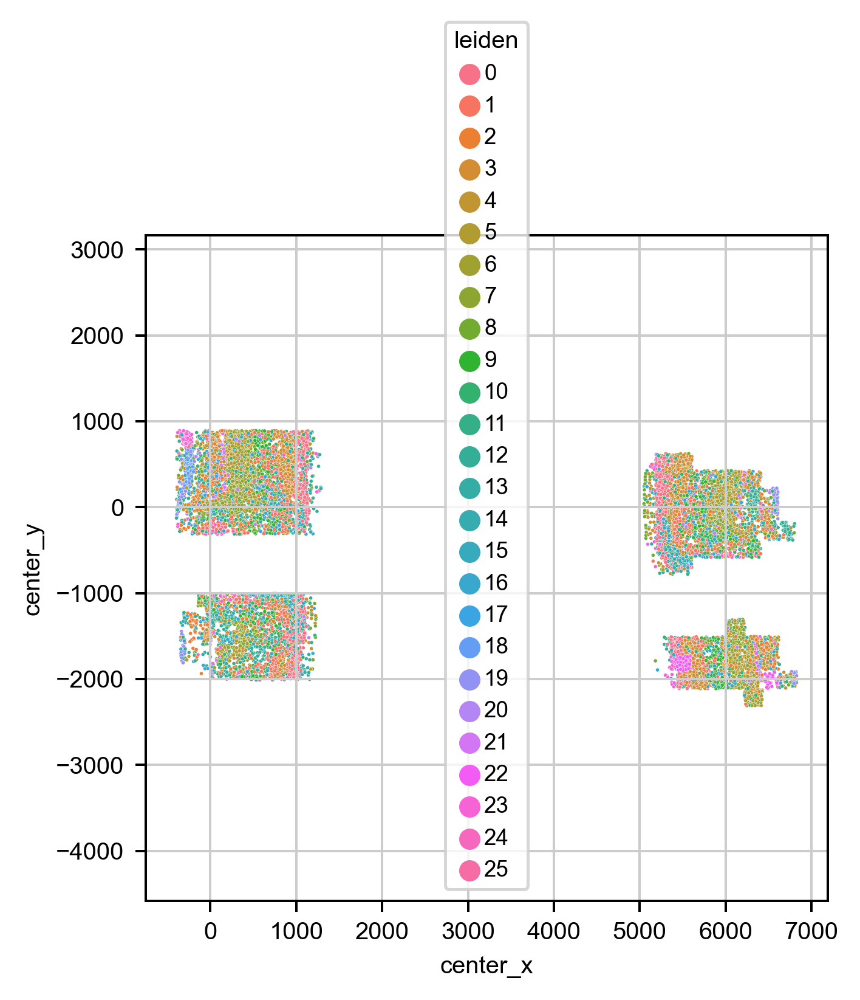

In [18]:
# visualzie the spatial dist for clusters
import matplotlib.pyplot as plt
sns.scatterplot(data=adata.obs, x='center_x', y='center_y', hue='leiden', s=1.5)
plt.axis('equal')

## 5. Check count for each cell for genes of interest

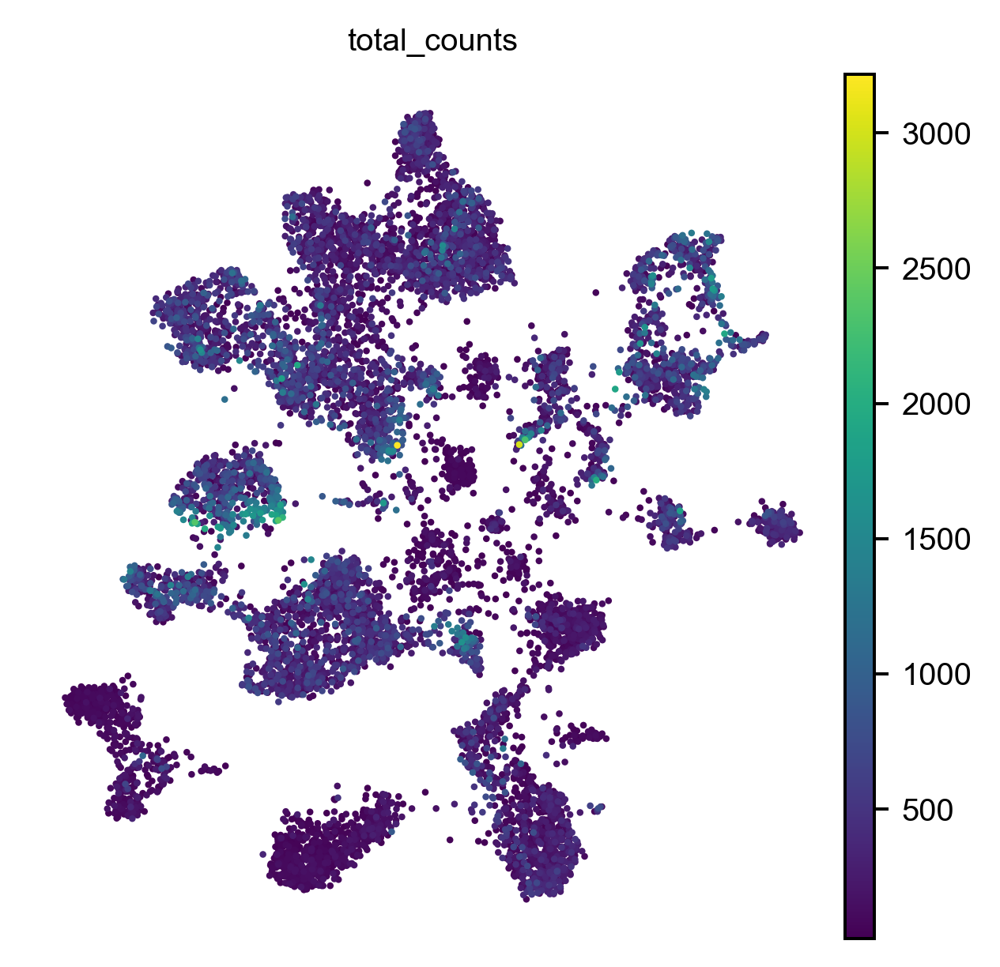

In [19]:
sc.pl.umap(adata, color='total_counts')

In [20]:
# load gene names
sel_gene_df = pd.read_excel(r'\\10.245.74.212\Chromatin_NAS_2\Chromatin_Libraries\CTP-12_mop_markers\smFISH_cell_class\MOP_marker_gene_readout.xlsx',
                          )
marker_genes = [_g for _g in sel_gene_df['Target gene'].values if (_g in adata.var.index)]
print(marker_genes)

['Slc30a3', 'Slc32a1', 'Otof', 'Rspo1', 'Sncg', 'Fam84b', 'Tshz2', 'Syt6', 'Nxph4', 'Cux2', 'Rorb', 'Sulf2', 'Ptpru', 'Car3', 'Aqp4', 'Flt1', 'Igf2', 'Pdgfra', 'Sox10', 'Ctss', 'Vtn', 'Bgn']


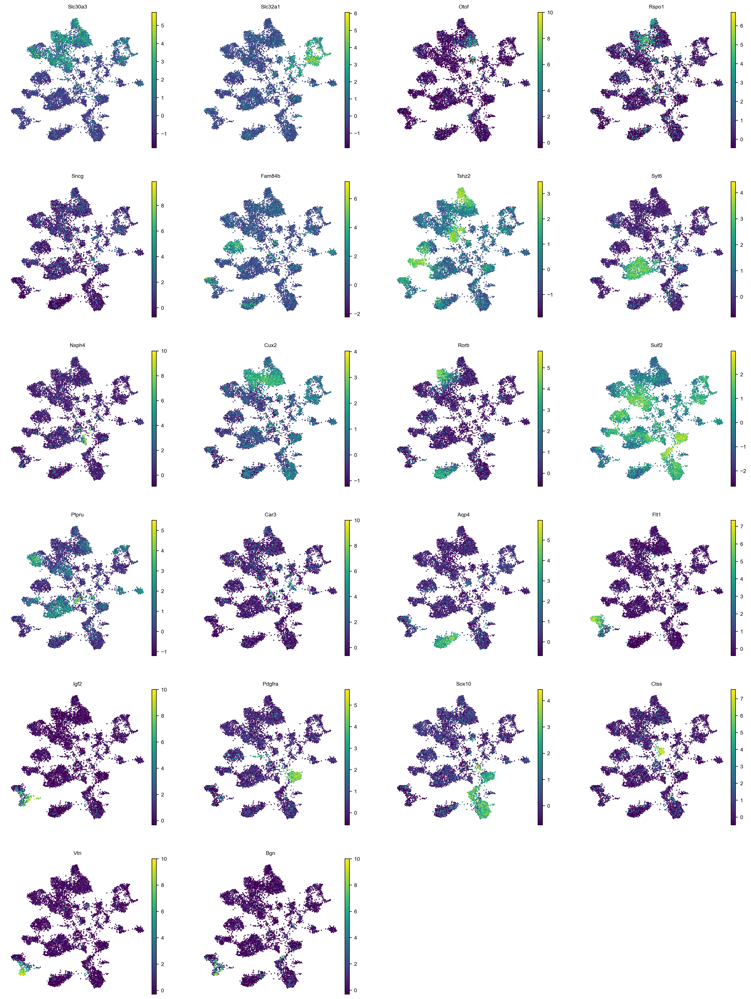

In [21]:
sc.pl.umap(adata, color=marker_genes)

## 6.UMAP can be done using different settings and can be saved into different label column for cell type classifer use later

## 6.1 Use higher expected pcs and resolution to UMAP for cell-type distinction at "cluster" level

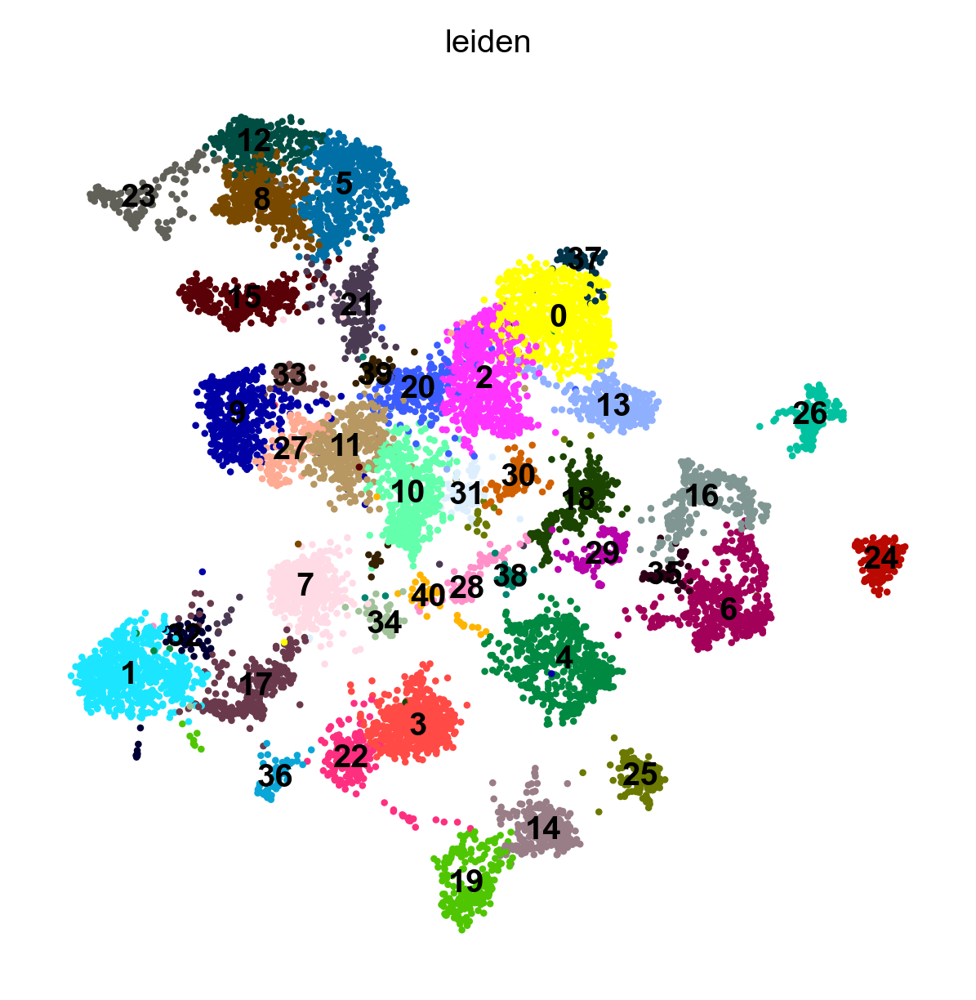

Wall time: 11.6 s


In [22]:
%%time
# Computing the neighborhood graph
sc.pp.neighbors(adata, n_neighbors=5, n_pcs=50)

sc.tl.leiden(adata, resolution=2)

sc.tl.umap(adata)
# Plot the UMAP
sc.pl.umap(adata, color='leiden', legend_loc='on data')

# save this labels as a new column as 'leiden_cluster'
adata.obs['leiden_cluster'] = adata.obs.leiden

## 6.2 Use lower expected pcs and resolution to UMAP for cell-type distinction at subclass level

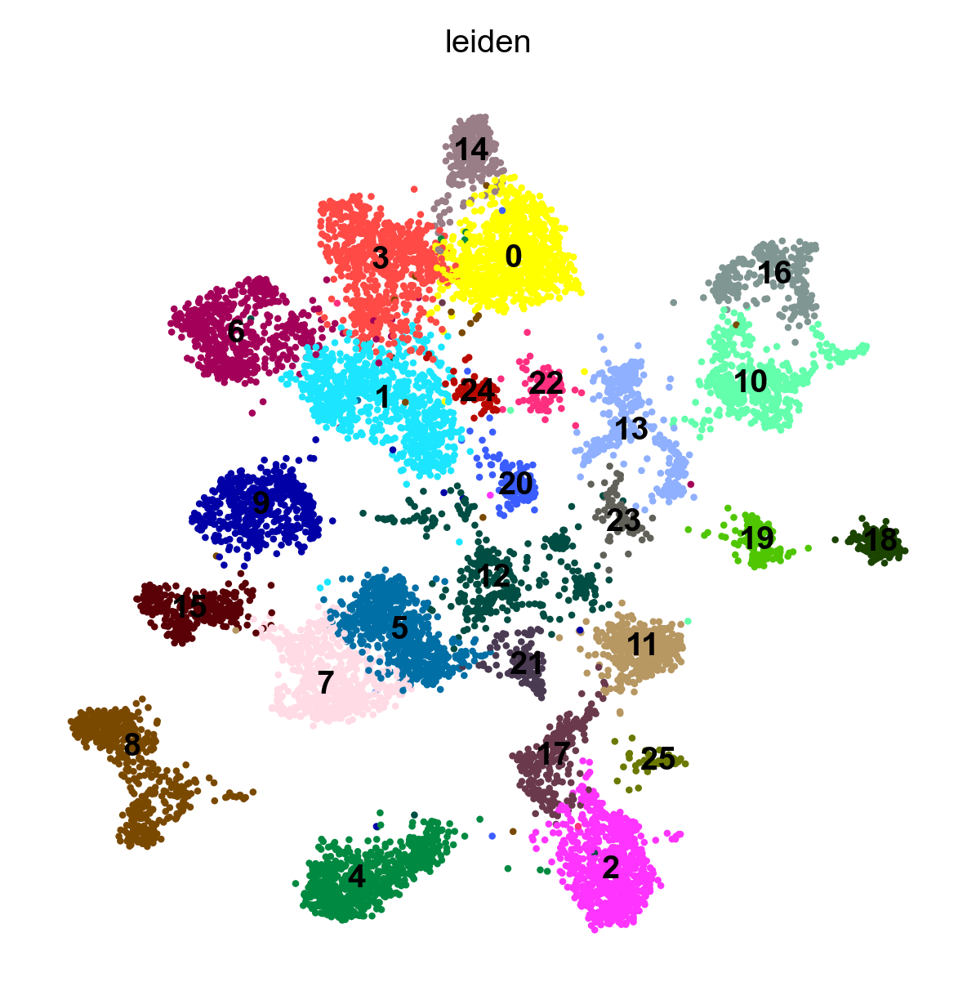

Wall time: 12.6 s


In [23]:
%%time
# Computing the neighborhood graph
sc.pp.neighbors(adata, n_neighbors=10, n_pcs=50)

sc.tl.leiden(adata, resolution=1)

sc.tl.umap(adata)
# Plot the UMAP
sc.pl.umap(adata, color='leiden', legend_loc='on data')

# save this new labels as a new column as 'leiden_subclass'
adata.obs['leiden_subclass'] = adata.obs.leiden

## 7. Save the analyzed MERFISH adata in h5ad for later use (e.g., cell classifer)

In [24]:
save_filename = os.path.join(os.path.join(postanalysis_folder, 'filtered_cluster_data.h5ad'))

overwrite = True

if not os.path.exists(save_filename) or overwrite:
    print(f"save adata into file: {save_filename}")
    adata.write(save_filename)
else:
    print(f"savefile: {save_filename} already exists")

save adata into file: I:\MERFISH_Analysis\20220314-P_brain_M1_adaptors\PostAnalysis\filtered_cluster_data.h5ad
